# Visualizing Midi with Pianorolls and Autoencoder

In [1]:
from IPython.display import display, Image, Audio

In [2]:
import pypianoroll

In [3]:
from midi2audio import FluidSynth
import matplotlib.pyplot as plt
from scipy import sparse
import pickle

In [4]:
from pylab import rcParams
rcParams['figure.figsize']=(15,14)

In [5]:
fs=FluidSynth(sample_rate=2**12, sound_font='TimGM6mb.sf2')

### Load a 5-track midi file in pianoroll representation

In [9]:
roll0 = pypianoroll.load('rolls/2b371cac2d74931ee7dd33184ebe5444.npz')

### Plot midi file by track. Y-axis is pitch for each instrument, X is time measured by beat.
#### This representation is essentially equivalent to music scores

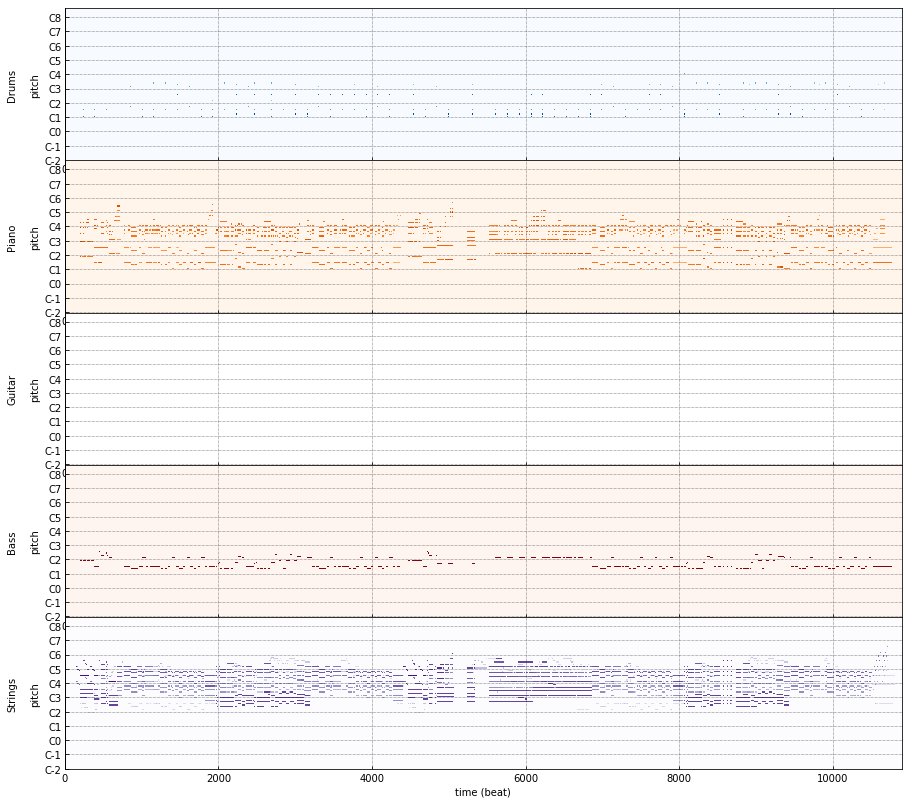

In [29]:
roll0.plot(mode='separate', xtick='off')
plt.show()

### Converting pianoroll to actuall midi file, then use a sound font to convert midi scores to sound wave for play back.

In [12]:
roll0.write('rolls/2b371cac2d74931ee7dd33184ebe5444_5track.mid')

In [40]:
fs.midi_to_audio('rolls/2b371cac2d74931ee7dd33184ebe5444_5track.mid', 'output0.wav')

In [8]:
Audio(filename='output0.wav')

## Visualization of midi file using autoencoder

### Convert pianoroll to a stacked sparse matrix representation

In [31]:
rollmat = sparse.csr_matrix(pypianoroll.load('rolls/2b371cac2d74931ee7dd33184ebe5444.npz').get_stacked_pianoroll().reshape([-1,128*5]))


In [50]:
pickle.dump(rollmat,open('rolls/rollmat.pkl','wb'))

In [ ]:
from fastai import *
from fastai.imports import *
from fastai.layers import SigmoidRange
from fastai.tabular import mean_absolute_error

from scipy import sparse

In [3]:
torch.cuda.is_available()
torch.cuda.set_device(1)
torch.cuda.current_device()

1

## Load Autoencoder Definition

In [4]:
class PianorollDS(Dataset):
    def __init__(self,data):
        self.data = scipy.sparse.vstack(data)
    def __len__(self):
        return self.data.shape[0]
    def __getitem__(self,idx):
        return self.data[idx]

In [5]:
def sparse2dense_collate(xs):
    return torch.from_numpy(np.transpose(scipy.sparse.vstack(xs).toarray().reshape(-1,128,5),(0,2,1)))

In [6]:
velocity_0lift = 12

def velocityTransform(x):
    return (x.clamp(0,1)*velocity_0lift + x.clamp(0,127)).type(torch.float32)/(128.+velocity_0lift)

In [7]:
velocity_range = np.array([0,127]).astype(np.uint8)
velocity_range_transformed = velocityTransform(torch.tensor(velocity_range))
velocity_range, velocity_range_transformed, velocityTransform(torch.tensor(1).type(torch.uint8))

(array([  0, 127], dtype=uint8), tensor([0.0000, 0.9929]), tensor(0.0929))

In [8]:
def velocityDetransform(x):
    return (( x.clamp(*velocity_range_transformed.numpy())*(128.+velocity_0lift) - velocity_0lift).clamp(*velocity_range) +0.5).type(torch.uint8)

In [9]:
velocityDetransform(velocity_range_transformed)
velocityDetransform(torch.tensor(.51))

tensor(59, dtype=torch.uint8)

In [10]:
class Autoencoder(nn.Module):
    def __init__(self):
        super(Autoencoder, self).__init__()
        self.encoder=nn.Sequential(                     #(5,128)
                            nn.Conv1d(5,40,12,groups=5), #(40,117)
                            nn.ReLU(),
                            nn.Conv1d(40,16,18,stride=11,groups=1), # (16,10), (kernel_size = 116-(out_size-1)*stride+1), 116=in_size-1
                            nn.ReLU(),
#                             nn.Conv1d(16,24,10,stride=1,groups=1), # (24,1), (kernel_size = 9-(out_size-1)*stride+1), 9=in_size-1
                            nn.Conv1d(16,87,10,stride=1,groups=1), # (24,1), (kernel_size = 9-(out_size-1)*stride+1), 9=in_size-1
                            nn.Sigmoid(),
                            )
        self.decoder=nn.Sequential(
#                             nn.ConvTranspose1d(24,16,10,stride=1),
                            nn.ConvTranspose1d(87,16,10,stride=1),
                            nn.ReLU(),
                            nn.ConvTranspose1d(16,40,18,stride=11),
                            nn.ReLU(),
                            nn.ConvTranspose1d(40,5,12),
#                             SigmoidRange(-0.7, 5),
                            SigmoidRange(-1.0, 2.0),
#                             nn.Tanh(),
#                             nn.ReLU()
        )

    def forward(self, x):
        encoding = self.encoder(x)
        x = self.decoder(encoding)
        return encoding.view(-1,3,29), x
    
    def get_encoder(self):
        return self.encoder
    def get_decoder(self):
        return self.decoder

In [12]:
autoencoder=Autoencoder().cuda()
# load trained model
autoencoder.load_state_dict(torch.load('conv_AE_drumFirst_allData-04.pth'))

In [13]:
def encode_song(sparse_song, staff_width = 512, staff_height=29, fname=None):
    autoencoder.eval()

    enc,_ = autoencoder(velocityTransform(torch.from_numpy(
        sparse_song.toarray().reshape(-1,128,5).transpose(0,2,1)
        )).cuda())

    song = enc.detach().cpu().numpy().transpose((2,0,1))

    song_folded = np.vstack(np.hsplit(np.pad(song, ((0,3),(0,staff_width-song.shape[1]%staff_width),(0,0)),'constant'),1+song.shape[1]//staff_width))
    
    if fname is not None:
        plt.imsave(fname, song_folded)
        print(fname+' saved', end='\r')
    else:
        plt.imshow(song_folded)
        plt.show()

In [14]:
rollmat = pickle.load(open('rolls/rollmat.pkl','rb'))

## Plot encoded music score
### note that music key changes can be seen when colour changes.

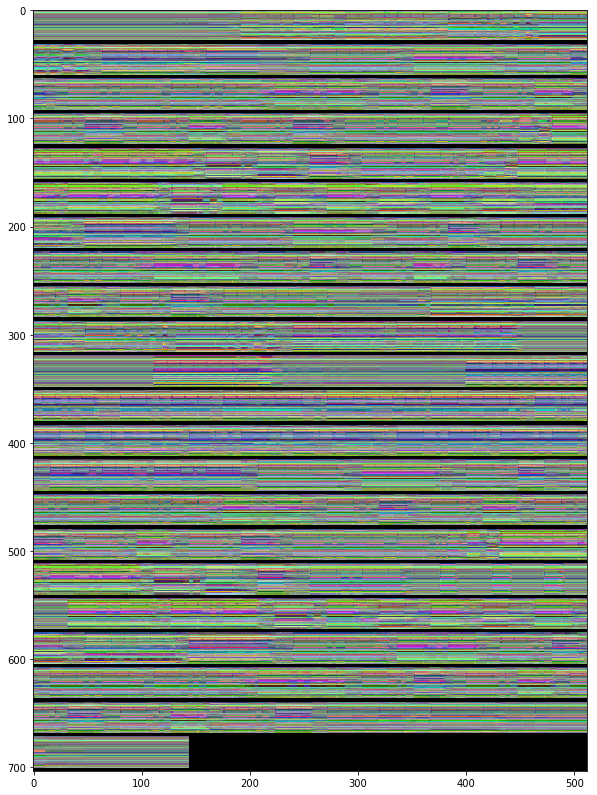

In [23]:
encode_song(rollmat)

## Replotting pianoroll for comparison:
### Key changes can't be clearly visualized in this representation

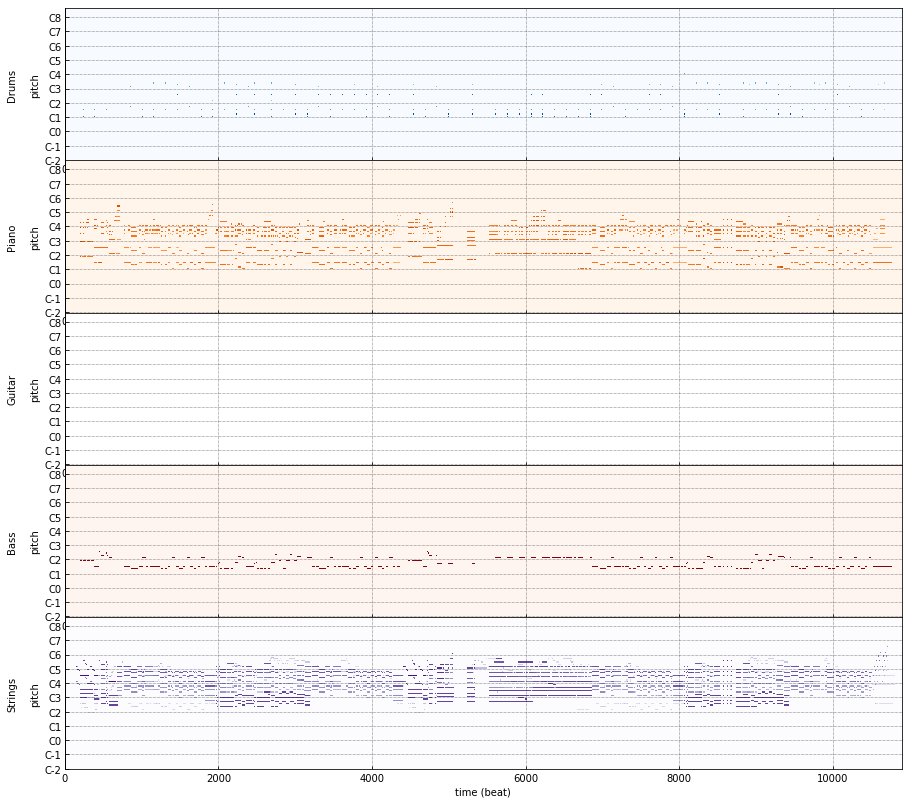

In [24]:
roll0.plot(mode='separate', xtick='off')
plt.show()

# Reconstructing a midi file from the decoding end

In [26]:
_,dec = autoencoder(velocityTransform(torch.from_numpy(
    rollmat.toarray().reshape(-1,128,5).transpose(0,2,1)
    )).cuda())

In [41]:
encTracks = velocityDetransform(dec).detach().cpu().numpy()#.reshape(-1,5*128)

In [42]:
encTracks.shape

(10896, 5, 128)

In [34]:
roll1=roll0.copy()

### Replace tracks with ones coming out of the autoencoder

In [45]:
for ti in range(5):
    roll1.tracks[ti].pianoroll=encTracks[:,ti,:]


In [46]:
roll1.save('rolls/roll1.npz')

## Pianoroll after encoding-decoding
### Very well preserved

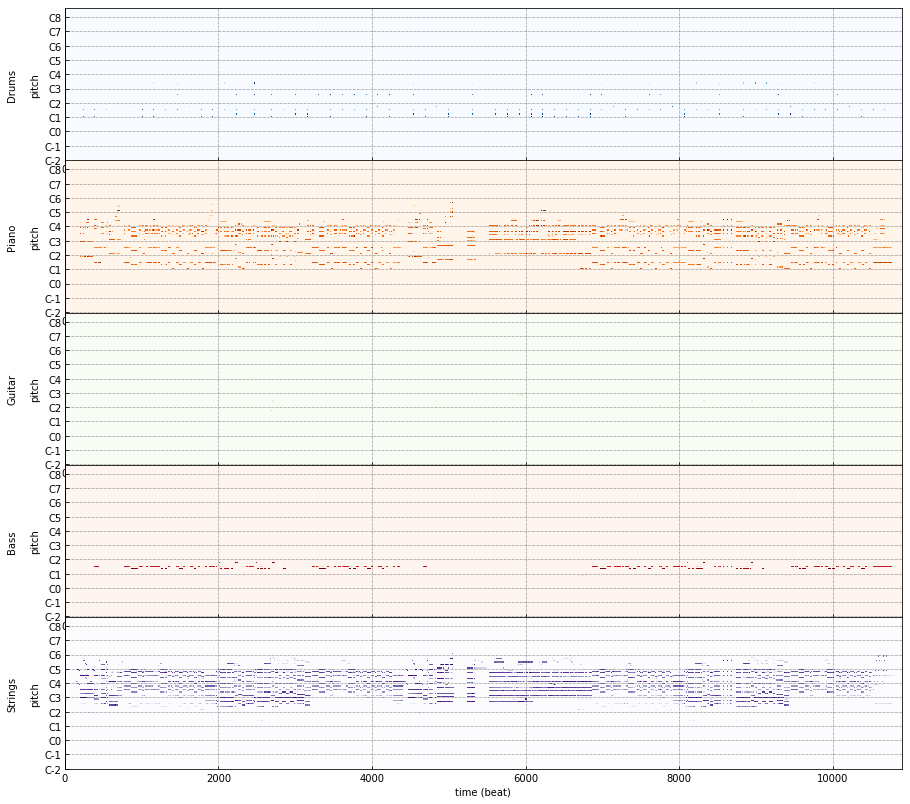

In [47]:
roll1.plot(mode='separate', xtick='off')
plt.show()

## Export reconstructed midi to sound file for listening

In [48]:
roll1.write('rolls/roll1_encode_decode.mid')

In [6]:
fs.midi_to_audio('rolls/roll1_encode_decode.mid', 'output1.wav')

In [7]:
Audio(filename='output1.wav')